<a href="https://colab.research.google.com/github/Anant-mishra1729/YOLOv9-Drone-detection/blob/main/Yolov9_drone_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip -q install opendatasets

In [2]:
import opendatasets as od

DATASET_URL = "https://www.kaggle.com/datasets/dasmehdixtr/drone-dataset-uav"
od.download(DATASET_URL)

Skipping, found downloaded files in "./drone-dataset-uav" (use force=True to force download)


## Making dataset compatible with Yolo format

The typical structure follows a clear hierarchy, like this:

```
Data
|-- data.yaml
|-- train
|   |-- images
|   `-- labels
|-- test
|   |-- images
|   `-- labels
`-- val
    |-- images
    `-- labels
```

* `data.yaml (Configuration File):` This file holds crucial settings for the training process, such as the paths to images and labels, along with other parameters relevant to your specific YOLO implementation.
* `train (Train Split):` This folder houses two subfolders:
    * images: This subfolder stores the images you'll use to train YOLO model.
    * labels: This subfolder contains corresponding label files.
    
Similarly for `test (Test split` and `val (Validation Split)`

In [3]:
from pathlib import Path
import os

DATA_DIR = Path("/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt")
print(len(os.listdir(DATA_DIR)))

2719


In [4]:
images = sorted(list(DATA_DIR.glob("*.jpg")))
print("Total images: ", len(images))
images[:5]

Total images:  1359


[PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0001.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0003.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0004.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0005.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0006.jpg')]

In [5]:
labels = sorted(list(DATA_DIR.glob("*.txt")))
print("Total labels: ", len(labels))
labels[:5]

Total labels:  1360


[PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0001.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0003.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0004.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0005.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0006.txt')]

## There is difference b/w count of labels and images, finding the redundant label

In [6]:
set([label_path.stem for label_path in labels]) - set([image_path.stem for image_path in images])

{'classes'}

#### There is a redundant file **"classes.txt"**

In [7]:
# Reading classes.txt
with open(DATA_DIR/"classes.txt", 'r') as f:
    print(f.read())

drone



In [8]:
# Removing classes.txt from labels list
FILE_TO_REMOVE = DATA_DIR / "classes.txt"
labels.remove(FILE_TO_REMOVE)

In [9]:
print("Images: ", len(images), " Labels: ", len(labels))

Images:  1359  Labels:  1359


## Generating dataset in YOLO format

```
Data
|-- data.yaml
|-- train
|   |-- images
|   `-- labels
|-- test
|   |-- images
|   `-- labels
`-- val
    |-- images
    `-- labels
```

### Creating directories and copying files

In [12]:
DATA_DIR = Path("Data")
TRAIN_DIR = DATA_DIR / "train"
TEST_DIR = DATA_DIR / "test"
VALIDATION_DIR = DATA_DIR / "val"
os.makedirs(TRAIN_DIR/ "images")
os.makedirs(TRAIN_DIR/ "labels")
os.makedirs(TEST_DIR/ "images")
os.makedirs(TEST_DIR/ "labels")
os.makedirs(VALIDATION_DIR/ "images")
os.makedirs(VALIDATION_DIR/ "labels")

In [13]:
# Splitting data into train and test data
from sklearn.model_selection import train_test_split

X_train,X_temp,y_train,y_temp = train_test_split(images, labels, test_size = 0.2)
X_val,X_test,y_val,y_test = train_test_split(X_temp, y_temp, test_size = 0.2)

In [14]:
print("Train image count: ", len(X_train))
print("Validation image count: ", len(X_val))
print("Test image count: ", len(X_test))

Train image count:  1087
Validation image count:  217
Test image count:  55


In [15]:
X_train[:5], y_train[:5]

([PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/foto07338.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/yoto01422.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_1140.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_924.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/foto02060.jpg')],
 [PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/foto07338.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/yoto01422.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_1140.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_924.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/foto02060.txt')])

In [16]:
import shutil
from tqdm.notebook import tqdm

def copyfiles(files, dest):
    print(f"Copying files to {dest}")
    for file in tqdm(files):
        shutil.copy(file, dest)

copyfiles(X_train, TRAIN_DIR/ "images")
copyfiles(y_train, TRAIN_DIR/ "labels")

copyfiles(X_test, TEST_DIR/ "images")
copyfiles(y_test, TEST_DIR/ "labels")

copyfiles(X_val, VALIDATION_DIR/ "images")
copyfiles(y_val, VALIDATION_DIR/ "labels")

Copying files to Data/train/images


  0%|          | 0/1087 [00:00<?, ?it/s]

Copying files to Data/train/labels


  0%|          | 0/1087 [00:00<?, ?it/s]

Copying files to Data/test/images


  0%|          | 0/55 [00:00<?, ?it/s]

Copying files to Data/test/labels


  0%|          | 0/55 [00:00<?, ?it/s]

Copying files to Data/val/images


  0%|          | 0/217 [00:00<?, ?it/s]

Copying files to Data/val/labels


  0%|          | 0/217 [00:00<?, ?it/s]

## Creating configuration file `data.yaml`

In [17]:
data_yaml = """
train: /content/Data/train/images
test: /content/Data/test/images
val: /content/Data/val/images

names:
  0: drone
"""

with open(DATA_DIR/"data.yaml", "w") as f:
    f.write(data_yaml)

In [18]:
os.listdir(DATA_DIR)

['data.yaml', 'val', 'test', 'train']

In [19]:
with open(DATA_DIR/"data.yaml", "r") as f:
    print(f.read())


train: /content/Data/train/images
test: /content/Data/test/images
val: /content/Data/val/images

names:
  0: drone



## Installing ultralytics and training the Yolov9c model

Removing `wandb` to avoid the unnecessary API Key request while training the model

In [20]:
!pip -q install ultralytics

In [21]:
from ultralytics import YOLO

model = YOLO("yolov9c.pt")

In [22]:
model.info()

YOLOv9c summary: 618 layers, 25590912 parameters, 0 gradients, 104.0 GFLOPs


(618, 25590912, 0, 104.02268160000003)

In [23]:
# Training yolov9c model
results = model.train(
    data = DATA_DIR/"data.yaml",
    epochs = 20,
    imgsz = 640
)

Ultralytics YOLOv8.2.31 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov9c.pt, data=Data/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, 

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


AMP: checks passed ✅


train: Scanning /content/Data/train/labels... 1087 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1087/1087 [00:02<00:00, 420.35it/s]

train: New cache created: /content/Data/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/Data/val/labels... 217 images, 0 backgrounds, 0 corrupt: 100%|██████████| 217/217 [00:00<00:00, 354.72it/s]

val: WARNING ⚠️ /content/Data/val/images/pic_722.jpg: corrupt JPEG restored and saved
val: New cache created: /content/Data/val/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      11.1G      1.609       2.16      1.819         35        640: 100%|██████████| 68/68 [00:59<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.12s/it]

                   all        217        241     0.0112      0.826     0.0109    0.00361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      11.2G       1.76      1.832      1.902         38        640: 100%|██████████| 68/68 [01:00<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.27it/s]

                   all        217        241     0.0148       0.66     0.0131    0.00403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      11.2G      1.775      1.816      1.898         45        640: 100%|██████████| 68/68 [00:55<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.85it/s]

                   all        217        241      0.047      0.083    0.00902    0.00288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      11.1G      1.738      1.665      1.867         47        640: 100%|██████████| 68/68 [00:54<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        241      0.393      0.394      0.357      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      11.2G      1.673      1.587      1.805         46        640: 100%|██████████| 68/68 [00:54<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.85it/s]

                   all        217        241      0.254      0.311      0.183     0.0586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      11.1G      1.642       1.57      1.765         45        640: 100%|██████████| 68/68 [00:55<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.82it/s]

                   all        217        241      0.455      0.573      0.484      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      11.3G      1.613       1.51      1.742         32        640: 100%|██████████| 68/68 [00:57<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]

                   all        217        241      0.683      0.577      0.663        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      11.3G      1.515      1.377      1.665         40        640: 100%|██████████| 68/68 [00:55<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.30it/s]

                   all        217        241      0.738      0.685      0.729      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      11.5G      1.481      1.313      1.623         40        640: 100%|██████████| 68/68 [00:54<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.87it/s]

                   all        217        241      0.614      0.614      0.605      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      11.3G      1.446      1.251      1.602         47        640: 100%|██████████| 68/68 [00:55<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.36it/s]

                   all        217        241      0.804      0.696      0.787       0.42


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      11.2G      1.365      1.131      1.697         15        640: 100%|██████████| 68/68 [00:57<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.85it/s]

                   all        217        241      0.672      0.707      0.704      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      11.1G      1.342      1.031      1.658         15        640: 100%|██████████| 68/68 [00:55<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.30it/s]

                   all        217        241      0.844      0.693      0.801       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      11.5G      1.336     0.9812      1.641         16        640: 100%|██████████| 68/68 [00:54<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.82it/s]

                   all        217        241      0.787      0.743      0.833      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      11.2G      1.321     0.9431      1.616         15        640: 100%|██████████| 68/68 [00:54<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.73it/s]

                   all        217        241      0.851      0.751      0.864      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      11.1G      1.218     0.8779      1.548         15        640: 100%|██████████| 68/68 [00:54<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        241      0.825       0.82      0.876      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      11.1G      1.217     0.8233      1.534         15        640: 100%|██████████| 68/68 [00:56<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.62it/s]

                   all        217        241      0.813       0.83      0.877      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      11.1G      1.165     0.8017      1.498         15        640: 100%|██████████| 68/68 [00:54<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        241      0.882      0.817      0.897      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      11.1G      1.123     0.7448       1.47         15        640: 100%|██████████| 68/68 [00:54<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.78it/s]

                   all        217        241      0.865       0.85      0.891      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      11.2G      1.098     0.7234      1.428         15        640: 100%|██████████| 68/68 [00:54<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.72it/s]

                   all        217        241      0.865      0.878      0.922      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      11.5G      1.098     0.6792      1.406         15        640: 100%|██████████| 68/68 [00:56<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]

                   all        217        241      0.907       0.88      0.942       0.61



20 epochs completed in 0.381 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 51.6MB
Optimizer stripped from runs/detect/train/weights/best.pt, 51.6MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.2.31 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv9c summary (fused): 384 layers, 25320019 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.03it/s]


                   all        217        241      0.906       0.88      0.942      0.609
Speed: 0.6ms preprocess, 12.2ms inference, 0.0ms loss, 4.1ms postprocess per image
Results saved to runs/detect/train


## Plotting validation metrics

(-0.5, 2999.5, 2249.5, -0.5)

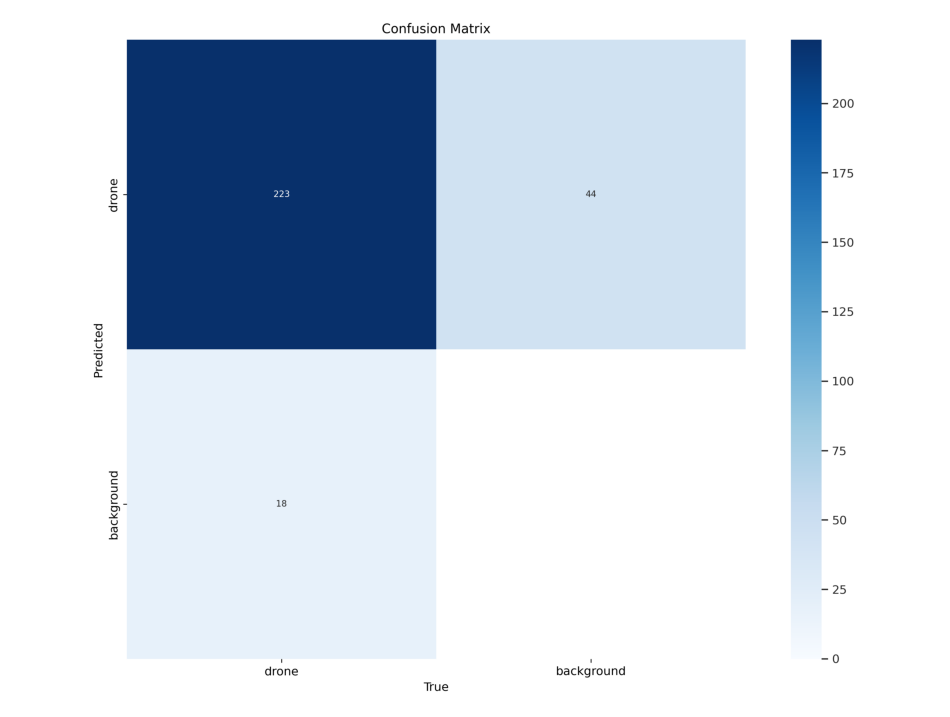

In [28]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

cnf = Image.open("runs/detect/train/confusion_matrix.png")
plt.figure(figsize = (12,12))
plt.imshow(np.asarray(cnf))
plt.axis('off')

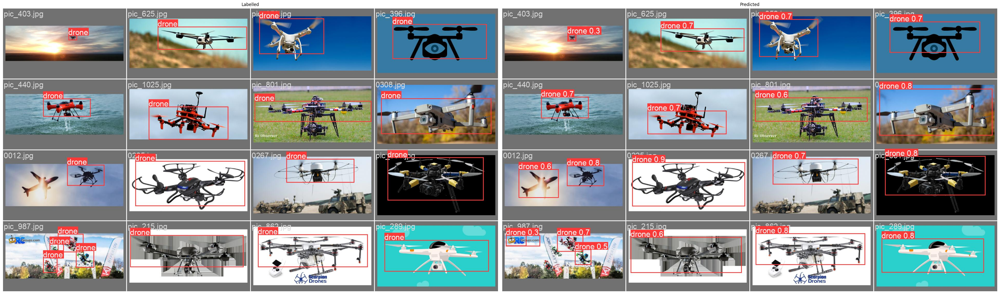

In [29]:
def show_pred(labelled_path, pred_path):
    plt.figure(figsize = (40,20))
    labelled = Image.open(labelled_path)
    predicted = Image.open(pred_path)
    plt.subplot(121)
    plt.title("Labelled")
    plt.imshow(np.asarray(labelled))
    plt.axis("off")
    plt.subplot(122)
    plt.title("Predicted")
    plt.imshow(np.asarray(predicted))
    plt.axis("off")
    plt.tight_layout()

show_pred("runs/detect/train/val_batch0_labels.jpg", "runs/detect/train/val_batch0_pred.jpg")

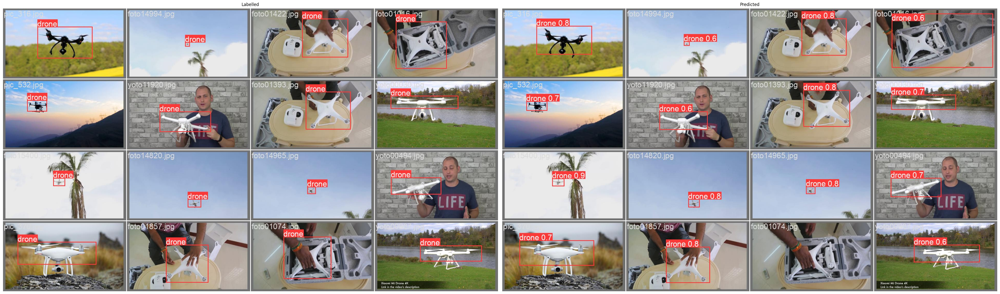

In [30]:
show_pred("runs/detect/train/val_batch1_labels.jpg", "runs/detect/train/val_batch1_pred.jpg")

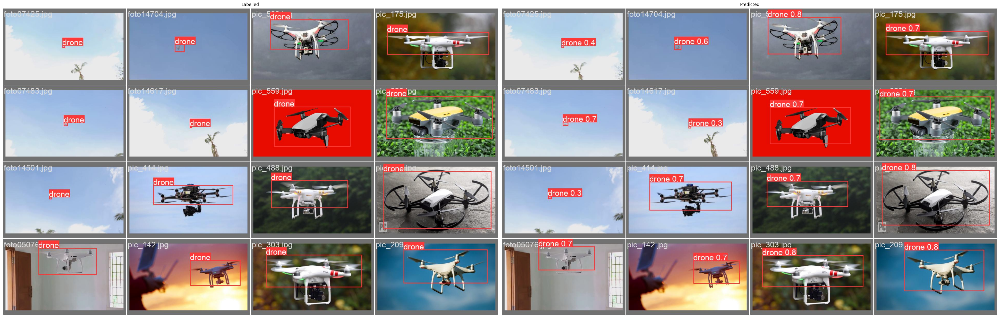

In [31]:
show_pred("runs/detect/train/val_batch2_labels.jpg", "runs/detect/train/val_batch2_pred.jpg")

## Generating results on test data

In [32]:
test_results = model.val(data=DATA_DIR/"data.yaml", split="test")

Ultralytics YOLOv8.2.31 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv9c summary (fused): 384 layers, 25320019 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning /content/Data/test/labels... 55 images, 0 backgrounds, 0 corrupt: 100%|██████████| 55/55 [00:00<00:00, 235.49it/s]

val: New cache created: /content/Data/test/labels.cache



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.13it/s]


                   all         55         61      0.915      0.882      0.954      0.637
Speed: 0.8ms preprocess, 42.7ms inference, 0.0ms loss, 2.8ms postprocess per image
Results saved to runs/detect/train2


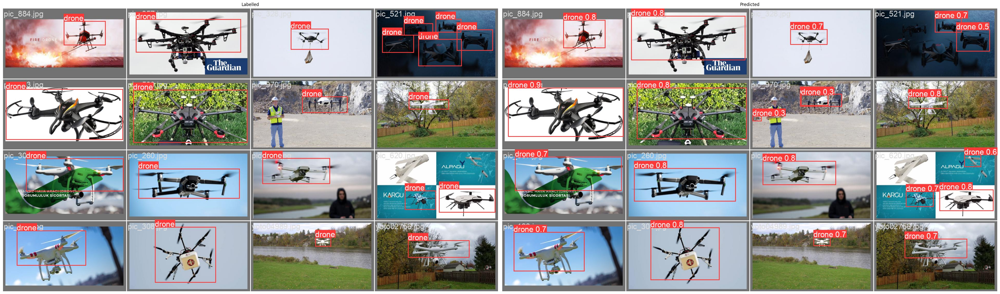

In [33]:
show_pred("runs/detect/train2/val_batch0_labels.jpg", "runs/detect/train2/val_batch0_pred.jpg")

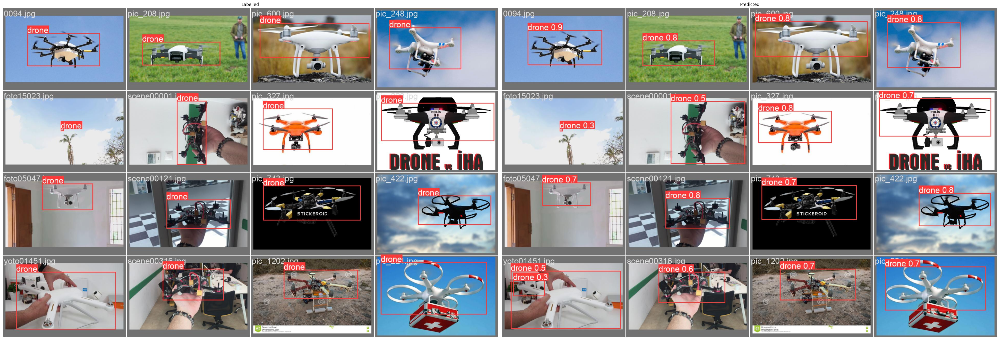

In [34]:
show_pred("runs/detect/train2/val_batch1_labels.jpg", "runs/detect/train2/val_batch1_pred.jpg")

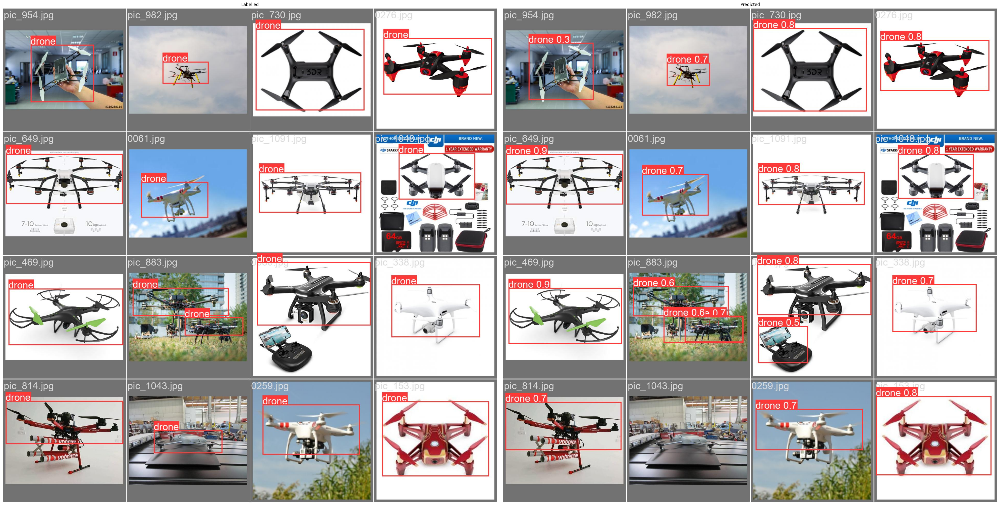

In [35]:
show_pred("runs/detect/train2/val_batch2_labels.jpg", "runs/detect/train2/val_batch2_pred.jpg")

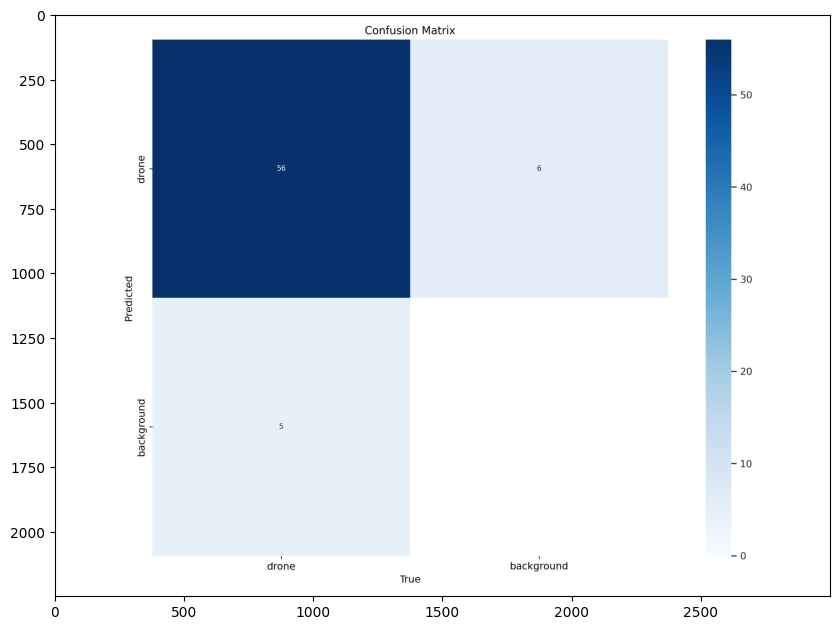

In [36]:
cnf = Image.open("runs/detect/train2/confusion_matrix.png")
plt.figure(figsize = (10,10))
plt.imshow(np.asarray(cnf))

## Predicting on random image

In [43]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"
!wget "https://res.cloudinary.com/engineering-com/image/upload/w_640,h_640,c_limit/Drone_Army_bloy3t.jpg"

--2024-06-11 15:48:04--  https://res.cloudinary.com/engineering-com/image/upload/w_640,h_640,c_limit/Drone_Army_bloy3t.jpg
Resolving res.cloudinary.com (res.cloudinary.com)... 104.19.167.65, 104.19.166.65, 2606:4700::6813:a741, ...
Connecting to res.cloudinary.com (res.cloudinary.com)|104.19.167.65|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 28598 (28K) [image/jpeg]
Saving to: ‘Drone_Army_bloy3t.jpg’

Drone_Army_bloy3t.j 100%[===================>]  27.93K  --.-KB/s    in 0s      

2024-06-11 15:48:05 (116 MB/s) - ‘Drone_Army_bloy3t.jpg’ saved [28598/28598]



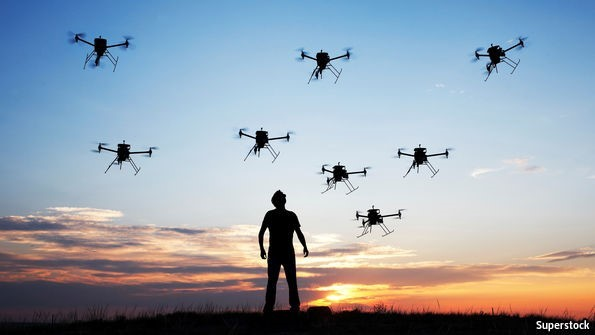

In [44]:
test_image = Image.open("Drone_Army_bloy3t.jpg")
test_image

In [45]:
test_image_results = model(test_image)[0]


0: 384x640 8 drones, 145.6ms
Speed: 2.4ms preprocess, 145.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


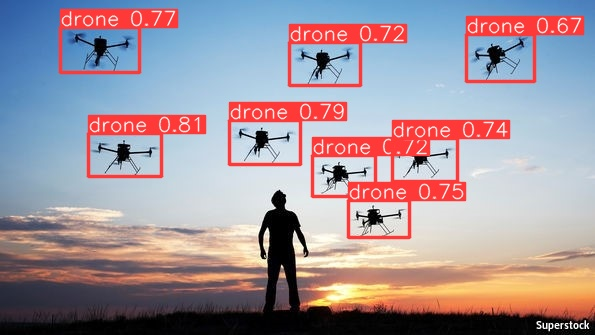

In [46]:
test_image_results.save("test_image_result.jpg")
Image.open("test_image_result.jpg")

## Downloading best weights



In [47]:
from google.colab import files
files.download('/content/runs/detect/train/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Loading best weights and predicting on a video

In [62]:
!pip -q install supervision

In [63]:
loaded_model = YOLO("/content/runs/detect/train/weights/best.pt")

In [64]:
loaded_model.info()

YOLOv9c summary: 618 layers, 25530003 parameters, 0 gradients, 103.7 GFLOPs


(618, 25530003, 0, 103.68291839999999)

In [71]:
results = model.track("test_video.mp4", save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/360) /content/test_video.mp4: 384x640 1 drone, 95.0ms
video 1/1 (frame 2/360) /content/test_video.mp4: 384x640 1 drone, 126.4ms
video 1/1 (frame 3/360) /content/test_video.mp4: 384x640 1 drone, 35.7ms
video 1/1 (frame 4/360) /content/test_video.mp4: 384x640 1 drone, 150.3ms
video 1/1 (frame 5/360) /content/test_video.mp4: 384x640 1 drone, 85.8ms
video 1/1 (frame 6/360) /content/test_video.mp4: 384x640 1 drone, 96.2ms
video 1/1 (frame

In [85]:
!ffmpeg -i /content/runs/detect/train3/test_video.avi -t 10 video.gif

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

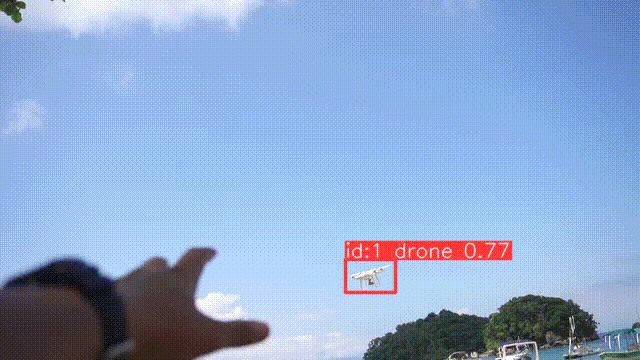

In [92]:
from IPython.display import Image

fname = 'video.gif'
Image(open(fname, 'rb').read())